## Setup

In [1]:
from IPython import get_ipython # type: ignore
ipython = get_ipython(); assert ipython is not None
ipython.run_line_magic("load_ext", "autoreload")
ipython.run_line_magic("autoreload", "2")

# Standard imports
import os
import torch
import numpy as np
from tqdm import tqdm
import plotly.express as px
import pandas as pd
import einops
from jaxtyping import Float, Int
from torch import Tensor

torch.set_grad_enabled(False)

# Device setup
GPU_TO_USE = 3

if torch.backends.mps.is_available():
    device = "mps"
else:
    device = f"cuda:{GPU_TO_USE}" if torch.cuda.is_available() else "cpu"

print(f"Device: {device}")

# utility to clear variables out of the memory & and clearing cuda cache
import gc
def clear_cache():
    gc.collect()
    torch.cuda.empty_cache()

Device: cuda:3


In [2]:
from pathlib import Path
import sys
import os

def get_base_folder(project_root = "tim-taras-sfc-errors"):
	# Find the project root dynamically
	current_dir = os.getcwd()
	while True:
		if os.path.basename(current_dir) == project_root:  # Adjust to match your project root folder name
			break
		parent = os.path.dirname(current_dir)
		if parent == current_dir:  # Stop if we reach the system root (failsafe)
			raise RuntimeError(f"Project root {project_root} not found. Check your folder structure.")
		current_dir = parent

	return current_dir

def get_project_folder(base_folder=None, project_folder_name='sfc-errors'):
	if base_folder is None:
		base_folder = get_base_folder()
	
	return Path(base_folder) / project_folder_name

def get_data_path(base_folder=None, data_folder_name='data'):
	if base_folder is None:
		base_folder = get_base_folder()

	return Path(base_folder) / data_folder_name

In [3]:
base_path = get_base_folder()
print(f"Base path: {base_path}")

project_path = get_project_folder(base_folder=base_path)
print(f"Project path: {project_path}")

sys.path.append(base_path)
sys.path.append(str(project_path))

Base path: /mnt/ssd-1/mechinterp/taras/tim-taras-sfc-errors
Project path: /mnt/ssd-1/mechinterp/taras/tim-taras-sfc-errors/sfc-errors


In [4]:
datapath = get_data_path(base_path) 
datapath

PosixPath('/mnt/ssd-1/mechinterp/taras/tim-taras-sfc-errors/data')

In [5]:
# Additionally, setup the logging file so that we can track the output even when disconnected from the front-end Jupyter interface
import sys
import logging

nblog = open("nb.log", "a+")
sys.stdout.echo = nblog
sys.stderr.echo = nblog

get_ipython().log.handlers[0].stream = nblog
get_ipython().log.setLevel(logging.INFO)

%autosave 5

Autosaving every 5 seconds


## Loading the model

We'll work with Gemma-2 2B (base version)

In [6]:
from sae_lens import HookedSAETransformer

USE_INSTRUCT = False
PARAMS_COUNT = 2

MODEL_NAME = f'gemma-2-{PARAMS_COUNT}b' + ('-it' if USE_INSTRUCT else '')
print(f'Using {MODEL_NAME}')

model = HookedSAETransformer.from_pretrained(MODEL_NAME, device=device, dtype=torch.bfloat16)
model

Using gemma-2-2b


Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

Loaded pretrained model gemma-2-2b into HookedTransformer


HookedSAETransformer(
  (embed): Embed()
  (hook_embed): HookPoint()
  (blocks): ModuleList(
    (0-25): 26 x TransformerBlock(
      (ln1): RMSNormPre(
        (hook_scale): HookPoint()
        (hook_normalized): HookPoint()
      )
      (ln1_post): RMSNorm(
        (hook_scale): HookPoint()
        (hook_normalized): HookPoint()
      )
      (ln2): RMSNormPre(
        (hook_scale): HookPoint()
        (hook_normalized): HookPoint()
      )
      (ln2_post): RMSNorm(
        (hook_scale): HookPoint()
        (hook_normalized): HookPoint()
      )
      (attn): GroupedQueryAttention(
        (hook_k): HookPoint()
        (hook_q): HookPoint()
        (hook_v): HookPoint()
        (hook_z): HookPoint()
        (hook_attn_scores): HookPoint()
        (hook_pattern): HookPoint()
        (hook_result): HookPoint()
        (hook_rot_k): HookPoint()
        (hook_rot_q): HookPoint()
      )
      (mlp): GatedMLP(
        (hook_pre): HookPoint()
        (hook_pre_linear): HookPoint()
      

## Loading the data

This uses my custom dataloader class, which parses raw data and prepares into a nice format for SFC, including providing some useful metadata such as token positions for where the answer should be, attention masks etc. The details of the class are convoluted because it was developed for a more general purpose than verb agreement tasks, so you can largely ignore the next few cells.

In [7]:
from classes.sfc_data_loader import SFCDatasetLoader
import utils.prompts as prompts
from utils.enums import *

In [8]:
DATASET_NAME = SupportedDatasets.VERB_AGREEMENT_TEST

dataloader = SFCDatasetLoader(DATASET_NAME, model, num_samples=10000,
                              local_dataset=True, base_folder_path=datapath)

EXPERIMENT = 'sva_rc_test'
saving_dir = datapath / EXPERIMENT

print(f'Using {SupportedDatasets.VERB_AGREEMENT_TEST} dataset and saving to the dir data/{EXPERIMENT}.')

Using SupportedDatasets.VERB_AGREEMENT_TEST dataset and saving to the dir data/sva_rc_test.


In [9]:
clean_dataset, corrupted_dataset = dataloader.get_clean_corrupted_datasets(tokenize=True, apply_chat_template=False, prepend_generation_prefix=True)

Figuring out optimal padding length...
Filtered out 431 longest prompts from a total of 10000 prompts.
Setting max prompt length to 8


100%|██████████| 9569/9569 [00:13<00:00, 715.75it/s]


Corrupted dataset here refers to the collection of patched prompts and their answers (verb completions) in the SFC paper terminology.

In [10]:
CONTROL_SEQ_LEN = clean_dataset['control_sequence_length'][0].item() # how many first tokens to ignore when computing SFC scores
N_CONTEXT = clean_dataset['prompt'].shape[1]

CONTROL_SEQ_LEN, N_CONTEXT

(2, 8)

In [11]:
print('Clean dataset:')
for prompt in clean_dataset['prompt'][:3]:
  print("\nPrompt:", model.to_string(prompt), end='\n\n')

  for i, tok in enumerate(prompt):
    str_token = model.to_string(tok)
    print(f"({i-CONTROL_SEQ_LEN}, {str_token})", end=' ')
  print()

print('Corrupted dataset:')
for prompt in corrupted_dataset['prompt'][:3]:
  print("\nPrompt:", model.to_string(prompt), end='\n\n')
  
  for i, tok in enumerate(prompt):
    str_token = model.to_string(tok)
    print(f"({i-CONTROL_SEQ_LEN}, {str_token})", end=' ')
  print()

Clean dataset:

Prompt: <bos>The women that the assistants influence<pad>

(-2, <bos>) (-1, The) (0,  women) (1,  that) (2,  the) (3,  assistants) (4,  influence) (5, <pad>) 

Prompt: <bos>The friends that the minister protects<pad>

(-2, <bos>) (-1, The) (0,  friends) (1,  that) (2,  the) (3,  minister) (4,  protects) (5, <pad>) 

Prompt: <bos>The men that the executive follows<pad>

(-2, <bos>) (-1, The) (0,  men) (1,  that) (2,  the) (3,  executive) (4,  follows) (5, <pad>) 
Corrupted dataset:

Prompt: <bos>The woman that the assistants influence<pad>

(-2, <bos>) (-1, The) (0,  woman) (1,  that) (2,  the) (3,  assistants) (4,  influence) (5, <pad>) 

Prompt: <bos>The friend that the minister protects<pad>

(-2, <bos>) (-1, The) (0,  friend) (1,  that) (2,  the) (3,  minister) (4,  protects) (5, <pad>) 

Prompt: <bos>The man that the executive follows<pad>

(-2, <bos>) (-1, The) (0,  man) (1,  that) (2,  the) (3,  executive) (4,  follows) (5, <pad>) 


In [12]:
# Sanity checks

# Control sequence length must be the same for all samples in both datasets
clean_ds_control_len = clean_dataset['control_sequence_length']
corrupted_ds_control_len = corrupted_dataset['control_sequence_length']

assert torch.all(corrupted_ds_control_len == corrupted_ds_control_len[0]), "Control sequence length is not the same for all samples in the dataset"
assert torch.all(clean_ds_control_len == clean_ds_control_len[0]), "Control sequence length is not the same for all samples in the dataset"
assert clean_ds_control_len[0] == corrupted_ds_control_len[0], "Control sequence length is not the same for clean and corrupted samples in the dataset"
assert clean_dataset['answer'].max().item() < model.cfg.d_vocab, "Clean answers exceed vocab size"
assert corrupted_dataset['answer'].max().item() < model.cfg.d_vocab, "Patched answers exceed vocab size"
assert (clean_dataset['answer_pos'] < N_CONTEXT).all().item(), "Answer positions exceed logits length"
assert (corrupted_dataset['answer_pos'] < N_CONTEXT).all().item(), "Answer positions exceed logits length"

# Setting up the SAEs

In [13]:
from classes.sfc_model import SFC_Gemma

RUN_WITH_SAES = True # we'll need to run the model with attached SAEs

# Determine the caching device, where we'll load our SAEs and compute the SFC scores
if RUN_WITH_SAES:
    caching_device = device 
else:
    caching_device = "cuda:0"


caching_device

'cuda:3'

For replicating the SFC part from the paper I used my custom SFC_Gemma class. In short, it
- Loads a Gemma model and its Gemma Scope SAEs (either attaching them to the model or not)
- Provides interface methods to compute SFC scores (currently, only attr patching is supported) on an arbitrary dataset (that follows the format of my SFCDatasetLoader class from above)

In [14]:
clear_cache()
sfc_model = SFC_Gemma(model, params_count=PARAMS_COUNT, control_seq_len=CONTROL_SEQ_LEN, 
                      attach_saes=RUN_WITH_SAES, caching_device=caching_device,
                      data_dir=datapath, experiment_name=EXPERIMENT)
clear_cache()

# sfc_model.print_saes()
# sfc_model.model.cfg
# , sfc_model.saes[0].cfg.dtype

Using 16K SAEs for the first 26 layers, the rest 0 layer(s) - 131k SAEs
Loaded SFC scores from /mnt/ssd-1/mechinterp/taras/tim-taras-sfc-errors/data/sva_rc_test/sfc_scores.pkl
Loaded mean activations from /mnt/ssd-1/mechinterp/taras/tim-taras-sfc-errors/data/sva_rc_test/mean_activations.pkl


# Main part

Here we'll call use CircuitEvaluator class, which encapsulates the SFC circuit evaluation logic.

In [15]:
from classes.sfc_evaluator import CircuitEvaluator

circuit_evaluator = CircuitEvaluator(sfc_model)

In [16]:
# Define utilities for displaying the features we'll select to restore
def display_selected_features(selected_nodes_info, sfc_node_scores, 
                              abs_scores=False, print_k_positions=10):
    """
    Display the selected nodes and their features in a readable format
    
    Args:
        selected_nodes_info: Tuple containing (feature_indices_dict, maximizing_positions_dict)
        sfc_node_scores: SFC_NodeScores object containing the node scores
        abs_scores: Whether to use absolute values when displaying scores
    """
    feature_indices_dict, maximizing_positions_dict = selected_nodes_info
    
    print(f"Selected features from {len(feature_indices_dict)} activations in total")
    
    for node_name, indices in feature_indices_dict.items():
        # Get maximizing positions for this node
        max_positions = maximizing_positions_dict[node_name]
        
        # Display the node with its indices
        print(f"\n• {node_name} ({len(indices)} features):")
        
        # If there are many indices, display them in a compact way
        if len(indices) > 10:
            # Show first 5 and last 5 with ellipsis in between
            indices_display = f"{indices[:5]} ... {indices[-5:]}"
        else:
            indices_display = str(indices)
        
        print(f"  Indices: {indices_display}")
        
        # Get the actual scores for these indices to show their importance
        node_scores = sfc_node_scores.node_scores[node_name]
        
        if node_scores.dim() > 1:  # SAE feature node
            # Print histogram of maximizing positions
            position_counts = {}
            for pos in max_positions.cpu().numpy():
                position_counts[int(pos)] = position_counts.get(int(pos), 0) + 1
            
            print("  Maximizing positions distribution:")
            for pos, count in sorted(position_counts.items()):
                percentage = 100 * count / len(indices)
                print(f"    Position {pos}: {count} features ({percentage:.1f}%)")
            
            # Display sample feature-position mappings
            sample_size = min(print_k_positions, len(indices))
            if sample_size > 0:
                print("\n  Sample features and their maximizing positions:")
                for i in range(sample_size):
                    feat_idx = indices[i] if isinstance(indices, list) else indices.tolist()[i]
                    pos = max_positions[i].item()
                    
                    # Get the score at the maximizing position
                    if abs_scores:
                        score = abs(node_scores[pos, feat_idx].item())
                    else:
                        score = node_scores[pos, feat_idx].item()
                    
                    print(f"    Feature {feat_idx}: position {pos}, score {score:.6f}")

def display_neuronpedia_features(selected_nodes_info, model_name='gemma-2-2b', max_features_per_type=3, 
                                 sfc_node_scores=None, abs_scores=False):
    """
    Display selected SAE features using Neuronpedia visualizations
    
    Args:
        selected_nodes_info: Tuple containing (feature_indices_dict, maximizing_positions_dict)
        model_name: Name of the model in Neuronpedia
        max_features_per_type: Maximum number of features to display per type
        sfc_node_scores: SFC_NodeScores object for scoring features (required for score-based selection)
        abs_scores: Whether to use absolute scores
    """
    from IPython.display import IFrame, display
    
    feature_indices_dict, maximizing_positions_dict = selected_nodes_info
    html_template = "https://neuronpedia.org/{}/{}/{}?embed=true&embedexplanation=true&embedplots=true&embedtest=true&height=300"
    
    # Collect features by type with their scores
    resid_features = []
    mlp_features = []
    attn_features = []
    
    for node_name, indices in feature_indices_dict.items():
        # Extract layer number from node name
        layer_num = int(node_name.split('.')[1])
        
        # Get maximizing positions
        max_positions = maximizing_positions_dict[node_name]
        
        # Get feature scores if sfc_node_scores is provided
        if sfc_node_scores is not None:
            node_scores = sfc_node_scores.node_scores[node_name]
            
            # Extract scores for these indices at their maximizing positions
            feature_scores = []
            for i, idx in enumerate(indices if isinstance(indices, list) else indices.tolist()):
                max_pos = max_positions[i].item()
                score = node_scores[max_pos, idx].item()
                if abs_scores:
                    score = abs(score)
                feature_scores.append(score)
        else:
            # Default scores to placeholder values if not provided, assuming indices are already sorted by importance
            feature_scores = [len(indices) - i for i in range(len(indices))]
        
        # Determine component type
        if 'hook_resid_post' in node_name:
            component_type = 'resid'
            features = resid_features
            sae_width = '16k'
        elif 'hook_mlp_out' in node_name:
            component_type = 'mlp'
            features = mlp_features
            sae_width = '16k'
        elif 'attn.hook_z' in node_name:
            component_type = 'attn'
            features = attn_features
            sae_width = '16k'
        else:
            continue  # Skip unknown component types
        
        # Add features with their maximizing positions and scores
        for i, idx in enumerate(indices if isinstance(indices, list) else indices.tolist()):
            max_pos = max_positions[i].item()
            score = feature_scores[i]
            features.append((layer_num, idx, max_pos, sae_width, score))
    
    # Display residual features (sorted by score)
    if resid_features:
        # Sort by score (highest first)
        resid_features.sort(key=lambda x: x[4], reverse=True)
        
        print(f"\n{'='*80}\nRESIDUAL STREAM FEATURES (Top {min(max_features_per_type, len(resid_features))} by score)\n{'='*80}")
        for i, (layer, idx, max_pos, sae_width, score) in enumerate(resid_features[:max_features_per_type]):
            print(f"\nFeature {i+1}/{min(max_features_per_type, len(resid_features))}")
            print(f"Layer: {layer}, Feature: {idx}, Maximizing Position: {max_pos}, Score: {score:.6f}")
            
            # Generate Neuronpedia URL
            sae_release = f'{layer}-gemmascope-res-{sae_width}'
            url = html_template.format(model_name, sae_release, idx)
            link_without_query = url.split('?')[0]
            
            print('Link:', link_without_query)
            display(IFrame(url, width=1200, height=400))
    
    # Display MLP features (sorted by score)
    if mlp_features:
        # Sort by score (highest first)
        mlp_features.sort(key=lambda x: x[4], reverse=True)
        
        print(f"\n{'='*80}\nMLP FEATURES (Top {min(max_features_per_type, len(mlp_features))} by score)\n{'='*80}")
        for i, (layer, idx, max_pos, sae_width, score) in enumerate(mlp_features[:max_features_per_type]):
            print(f"\nFeature {i+1}/{min(max_features_per_type, len(mlp_features))}")
            print(f"Layer: {layer}, Feature: {idx}, Maximizing Position: {max_pos}, Score: {score:.6f}")
            
            # Generate Neuronpedia URL
            sae_release = f'{layer}-gemmascope-mlp-{sae_width}'
            url = html_template.format(model_name, sae_release, idx)
            link_without_query = url.split('?')[0]
            
            print('Link:', link_without_query)
            display(IFrame(url, width=1200, height=400))
    
    # For attention features (no visualization available yet)
    if attn_features:
        # Sort by score (highest first)
        attn_features.sort(key=lambda x: x[4], reverse=True)
        
        print(f"\n{'='*80}\nATTENTION FEATURES (Top {min(max_features_per_type, len(attn_features))} by score)\n{'='*80}")
        for i, (layer, idx, max_pos, _, score) in enumerate(attn_features[:max_features_per_type]):
            print(f"Layer: {layer}, Feature: {idx}, Maximizing Position: {max_pos}, Score: {score:.6f}")
            print("No Neuronpedia visualization available for attention features")

## Defining the set of SAE latents to restore

Here we'll inspect the features we'll be restoring in the code. Restoring means:
- Patching in original activations from unaffected pass (w/o ablations), into the forward pass that is affected by ablations.
- i.e. patching in feature activations as they would have been without any ablations

In [17]:
layers_to_extract = [
    # [18, 19, 20, 21, 22, 23, 24, 25],
    # [18, 19, 20, 21, 22, 23, 24],
    # [18, 19, 20, 21, 22, 23],
    # [18, 19, 20, 21, 22],
    [18, 19, 20, 21],
    [18, 19, 20],
    [18, 19],
    [18]
]
top_k_counts = [5, 10, 25, 50, 100]
positions_to_select = [2, 6]  # Only restore features at these token positions - same positions where we'll ablate the error nodes

extraction_params = {
    'abs_scores': False,
    'aggregation_type': 'max',
    'positions_to_select': positions_to_select,
    'include_components': [
                           'hook_resid_post', 
                           'attn.hook_z', 
                           'hook_mlp_out',
                          ]
}

In [18]:
# Store aggregation settings for consistent display
abs_scores = extraction_params['abs_scores']

for layer_idx, layer in enumerate(layers_to_extract):
    print(f"\n{'='*80}\nLAYER {layer}\n{'='*80}")
    
    for top_k_value in top_k_counts:
        print(f"\n{'-'*60}\nTop {top_k_value} features\n{'-'*60}")
        
        # Extract just this layer with the specified top_k value
        selected_nodes_info = circuit_evaluator.sfc_node_scores.get_top_k_features_by_layer(
            layer, 
            top_k_counts=top_k_value,
            verbose=False,  # Turn off built-in verbose output for cleaner display
            **extraction_params
        )
        
        # Display the selected nodes with their maximizing positions
        display_selected_features(selected_nodes_info, circuit_evaluator.sfc_node_scores, abs_scores, print_k_positions=0)
        
        # Optionally display Neuronpedia visualizations for top features by score
        # display_neuronpedia_features(
        #     selected_nodes_info, 
        #     max_features_per_type=3,
        #     sfc_node_scores=circuit_evaluator.sfc_node_scores,
        #     abs_scores=abs_scores
        # )


LAYER [18, 19, 20, 21]

------------------------------------------------------------
Top 5 features
------------------------------------------------------------
Selected features from 12 activations in total

• blocks.18.attn.hook_z.hook_sae_acts_post (5 features):
  Indices: [9435, 1778, 7911, 9711, 9639]
  Maximizing positions distribution:
    Position 6: 5 features (100.0%)

• blocks.18.hook_mlp_out.hook_sae_acts_post (5 features):
  Indices: [8691, 16218, 12557, 13970, 4595]
  Maximizing positions distribution:
    Position 2: 4 features (80.0%)
    Position 6: 1 features (20.0%)

• blocks.18.hook_resid_post.hook_sae_acts_post (5 features):
  Indices: [10665, 1506, 4442, 15377, 1271]
  Maximizing positions distribution:
    Position 2: 3 features (60.0%)
    Position 6: 2 features (40.0%)

• blocks.19.attn.hook_z.hook_sae_acts_post (5 features):
  Indices: [3716, 10073, 10884, 10500, 6714]
  Maximizing positions distribution:
    Position 6: 5 features (100.0%)

• blocks.19.hook_

## Running the ablation & restoration loop (variable top-k)

Main experiment of the notebook: ablate ALL residual error nodes from the most important positions (2 and 6), and try to restore a variable number of latents from a variable range of layers => see how much faithfulness we can recover. More details [here](https://docs.google.com/document/d/1vZrGsoGDEu5MLcL9Iisi0mctW1c-6j37sdSP88GfWaA/edit?tab=t.0#heading=h.ph3mduyhoipd)

In [19]:
import pandas as pd
from collections import defaultdict

# ablate all resid error nodes up until (and including) this threshold 
ERRORS_LAYER_THRESHOLD_TOP = 25
ERRORS_LAYER_THRESHOLD_BOTTOM = 0

# Define error ablation function for this threshold
def ablate_error_hook(act_name):
    if 'hook_resid_post.hook_sae_error' not in act_name:
        return False
        
    # Split the input string by periods
    parts = act_name.split('.')
    error_layer_num = int(parts[1])
    
    return ERRORS_LAYER_THRESHOLD_BOTTOM <= error_layer_num <= ERRORS_LAYER_THRESHOLD_TOP

# Consult the CircuitEvaluator.evaluate_circuit_faithfulness() method documentation for the meaning of the params below
evaluation_params = {
    'cutoff_early_layers': False,
    'nodes_to_always_ablate': ablate_error_hook,
    'always_ablate_positions': positions_to_select,
    'nodes_to_always_ablate': ablate_error_hook,
    
    'batch_size': 1024,
    'total_batches': None,
    'verbose': True
}

# Initialize data collection structures
results = defaultdict(list)
detailed_results = {}  # For storing comprehensive data that doesn't fit in a dataframe

# Store aggregation settings for consistent display
abs_scores = extraction_params['abs_scores']

In [20]:
# Reset the hooks to avoid weird bugs
sfc_model.model.reset_hooks()
if RUN_WITH_SAES:
    sfc_model._reset_sae_hooks()
clear_cache()

In [ ]:
for layer_idx, layer in enumerate(layers_to_extract):
    print(f"\n{'='*80}\nLAYER {layer}\n{'='*80}")
    
    for top_k_value in top_k_counts:
        print(f"\n{'-'*60}\nTop {top_k_value} features\n{'-'*60}")
        
        # Create a unique key for this configuration
        config_key = f"layer_{layer}_top_{top_k_value}"
        
        # Extract just this layer with the specified top_k value
        selected_nodes_info = circuit_evaluator.sfc_node_scores.get_top_k_features_by_layer(
            layer, 
            top_k_counts=top_k_value,
            verbose=False,  # Turn off built-in verbose output for cleaner display
            **extraction_params
        )
        
        # Unpack the returned data
        feature_indices_dict, maximizing_positions_dict = selected_nodes_info
        
        # Save the detailed feature information
        detailed_results[config_key] = {
            'feature_indices': feature_indices_dict,
            'maximizing_positions': maximizing_positions_dict,
            'layer': layer,
            'top_k': top_k_value
        }
        
        # Display the selected nodes with their maximizing positions (optional)
        # display_selected_features(selected_nodes_info, circuit_evaluator.sfc_node_scores, abs_scores, print_k_positions=0)
        
        # Prepare nodes_to_restore and feature_indices_to_restore for circuit evaluation
        nodes_to_restore = list(feature_indices_dict.keys())  # All nodes with selected features
        
        # Evaluate circuit faithfulness
        faithfulness_metrics, n_nodes_in_circuit = circuit_evaluator.evaluate_circuit_faithfulness(
            clean_dataset=clean_dataset,
            patched_dataset=corrupted_dataset,
            # comment out these lines if you want to get the baseline faithfulness (without restoration)
            nodes_to_restore=nodes_to_restore,
            feature_indices_to_restore=feature_indices_dict,
            # ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
            return_all_metrics=True,
            **evaluation_params
        )
        
        # Before computing the mean and std metrics, filter out infs which seem to be pathological
        faithfulness_finite_mask = torch.isfinite(faithfulness_metrics)
        infinite_values_count = (~faithfulness_finite_mask).sum()
        if infinite_values_count > 0:
            print(f'Filtered out {infinite_values_count} infinite metrics')
        
        mean_faithfulness = faithfulness_metrics[faithfulness_finite_mask].mean().item()
        std_faithfulness = faithfulness_metrics[faithfulness_finite_mask].std().item()
        
        # Store all the results
        results['layer'].append(layer)
        results['top_k'].append(top_k_value)
        results['num_selected_features'].append(sum(len(indices) for indices in feature_indices_dict.values()))
        results['circuit_size'].append(n_nodes_in_circuit)
        results['mean_faithfulness'].append(mean_faithfulness)
        results['std_faithfulness'].append(std_faithfulness)

        # Save the actual faithfulness metrics tensor for potential future analysis
        metric_save_path = saving_dir / f'faithfulness_metrics_layer_{max(layer)}_topk_{top_k_value}.pt'
        torch.save(faithfulness_metrics, metric_save_path)
        
        # Also collect position statistics
        position_stats = {}
        for node_name, positions in maximizing_positions_dict.items():
            # Convert to numpy array for easier analysis
            pos_array = positions.cpu().numpy()
            position_stats[node_name] = {
                'position_counts': {int(pos): int(count) for pos, count in 
                                   zip(*np.unique(pos_array, return_counts=True))}
            }
        
        detailed_results[config_key]['position_stats'] = position_stats
        
        # Compute overall position distribution
        all_positions = []
        for positions in maximizing_positions_dict.values():
            all_positions.extend(positions.cpu().numpy())
            
        if all_positions:
            position_counts = {int(pos): int(count) for pos, count in 
                              zip(*np.unique(all_positions, return_counts=True))}
            results['position_distribution'].append(str(position_counts))
        else:
            results['position_distribution'].append("{}")
        
        print(f"Layer {layer}, Top {top_k_value}: Mean faithfulness = {mean_faithfulness:.4f}")

        del faithfulness_metrics
        clear_cache()


LAYER [18, 19, 20, 21]

------------------------------------------------------------
Top 5 features
------------------------------------------------------------
Restoring 12 nodes.
Restoring 60 specific features across 12 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.0.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.1.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.

  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.0.attn.hook_z.hook_sae_acts_post in 131072 positions
Ablating blocks.0.attn.hook_z.hook_sae_error in 8 positions
Ablating blocks.0.hook_mlp_out.hook_sae_acts_post in 131072 positions
Ablating blocks.0.hook_mlp_out.hook_sae_error in 8 positions
Ablating blocks.0.hook_resid_post.hook_sae_acts_post in 131072 positions
Ablating blocks.0.hook_resid_post.hook_sae_error in 8 positions
Ablating blocks.1.attn.hook_z.hook_sae_acts_post in 131072 positions
Ablating blocks.1.attn.hook_z.hook_sae_error in 8 positions
Ablating blocks.1.hook_mlp_out.hook_sae_acts_post in 131072 positions
Ablating blocks.1.hook_mlp_out.hook_sae_error in 8 positions
Ablating blocks.1.hook_resid_post.hook_sae_acts_post in 131072 positions
Ablating blocks.1.hook_resid_post.hook_sae_error in 8 positions
Ablating blocks.2.attn.hook_z.hook_sae_acts_post in 131072 positions
Ablating blocks.2.attn.hook_z.hook_sae_error in 8 positions
Ablating blocks.2.hook_mlp_out.hook_sae_acts_post in 131072 positions
Ablatin

  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.0.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.1.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.

  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.0.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.1.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.

  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.0.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.1.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.

  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.0.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.1.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.

  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.0.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.1.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.

In [25]:
# Create DataFrame from the collected results
results_df = pd.DataFrame(results)

SAVING_NAME_SUFFIX = ''
SAVING_NAME_SUFFIX = '_' + SAVING_NAME_SUFFIX if SAVING_NAME_SUFFIX else SAVING_NAME_SUFFIX

SAVING_NAME_RESULTS = f'faithfulness_with_different_topk{SAVING_NAME_SUFFIX}.csv'
SAVING_NAME_DETAILED = f'faithfulness_with_different_topk_detailed{SAVING_NAME_SUFFIX}.csv'
# Display the results
print("\nSummary of results:")
print(results_df)

# If needed, convert layer values to proper types
# This handles cases where layer might be a list or the last element of a range
results_df['layer'] = results_df['layer'].apply(lambda x: x if isinstance(x, int) else max(x))

# Save the results for future use
results_df.to_csv(saving_dir / SAVING_NAME_RESULTS, index=False)

# Save detailed results as pickle
import pickle
with open(saving_dir / SAVING_NAME_DETAILED, "wb") as f:
    pickle.dump(detailed_results, f)

print(f"\nResults saved to {SAVING_NAME_RESULTS} and {SAVING_NAME_DETAILED} within {saving_dir}")


Summary of results:
               layer  top_k  num_selected_features  circuit_size  \
0   [18, 19, 20, 21]      5                     60      10224188   
1   [18, 19, 20, 21]     10                    120      10224188   
2   [18, 19, 20, 21]     25                    300      10224188   
3   [18, 19, 20, 21]     50                    600      10224188   
4   [18, 19, 20, 21]    100                   1200      10224188   
5       [18, 19, 20]      5                     45      10224188   
6       [18, 19, 20]     10                     90      10224188   
7       [18, 19, 20]     25                    225      10224188   
8       [18, 19, 20]     50                    450      10224188   
9       [18, 19, 20]    100                    900      10224188   
10          [18, 19]      5                     30      10224188   
11          [18, 19]     10                     60      10224188   
12          [18, 19]     25                    150      10224188   
13          [18, 19]     50

### Plotting

In [26]:
def plot_faithfulness_vs_layer_ranges(results_df, layers_to_extract):
    """
    Plot faithfulness vs layer ranges, using the last layer in each range for x-axis positioning
    
    Args:
        results_df: DataFrame containing the results
        layers_to_extract: List of layer ranges used in the experiment
                           e.g., [[18, 19, 20, 21, 22], [18, 19, 20, 21], ...]
    """
    import matplotlib.pyplot as plt
    import numpy as np
    
    plt.figure(figsize=(12, 7))
    
    # Extract the last (highest) layer from each range
    highest_layers = [max(layer_range) for layer_range in layers_to_extract]
    
    # Create x-axis labels that show the layer ranges
    x_labels = [f"{min(layer_range)}-{max(layer_range)}" if len(layer_range) > 1 
                else f"{layer_range[0]}" for layer_range in layers_to_extract]
    
    # Get unique top_k values
    top_k_values = sorted(results_df['top_k'].unique())
    
    # Set up colors for different top_k values
    colors = plt.cm.viridis(np.linspace(0, 1, len(top_k_values)))
    markers = ['o', 's', '^', 'D', 'v', '<', '>']  # Different markers for different top_k values
    
    # For each top_k value, plot a line showing faithfulness vs layer range
    for i, k in enumerate(top_k_values):
        # Filter data for this top_k value
        k_data = results_df[results_df['top_k'] == k]
        
        # Create mapping from highest layer to row index
        layer_to_index = {highest_layers[i]: i for i in range(len(highest_layers))}
        
        # Prepare data points for plotting
        x_positions = []
        y_values = []
        y_errors = []
        
        for highest_layer in highest_layers:
            # Find the corresponding row in results_df
            matching_rows = k_data[k_data['layer'] == highest_layer]
            
            if not matching_rows.empty:
                # Get the first matching row
                row = matching_rows.iloc[0]
                
                x_positions.append(highest_layer)
                y_values.append(row['mean_faithfulness'])
                if 'std_faithfulness' in row:
                    y_errors.append(row['std_faithfulness'])
                else:
                    y_errors.append(0)
        
        if x_positions:
            # Plot the line
            plt.errorbar(x_positions, y_values, yerr=y_errors, 
                        marker=markers[i % len(markers)], color=colors[i],
                        linestyle='-', linewidth=2, markersize=8,
                        label=f'Top {k} features', capsize=5)
    
    # Customize the plot
    plt.xlabel('Layer Range', fontsize=14)
    plt.ylabel('Faithfulness', fontsize=14)
    plt.title('Faithfulness vs Layer Ranges for Different Feature Counts', fontsize=16)
    
    # Set custom x-ticks with range labels
    plt.xticks(highest_layers, x_labels, rotation=45)
    
    # Add grid, legend, etc.
    plt.grid(alpha=0.3)
    plt.legend(fontsize=12)
    plt.tight_layout()
    
    # Save the plot
    plt.savefig('faithfulness_vs_layer_ranges.png', dpi=300)
    plt.show()
    
    # Print summary statistics
    print("Layer Range Faithfulness Summary:")
    for i, layer_range in enumerate(layers_to_extract):
        range_label = x_labels[i]
        highest_layer = highest_layers[i]
        
        print(f"\nLayer Range {range_label}:")
        for k in top_k_values:
            matching_rows = results_df[(results_df['layer'] == highest_layer) & (results_df['top_k'] == k)]
            if not matching_rows.empty:
                mean_faith = matching_rows['mean_faithfulness'].iloc[0]
                print(f"  Top {k} features: {mean_faith:.4f}")

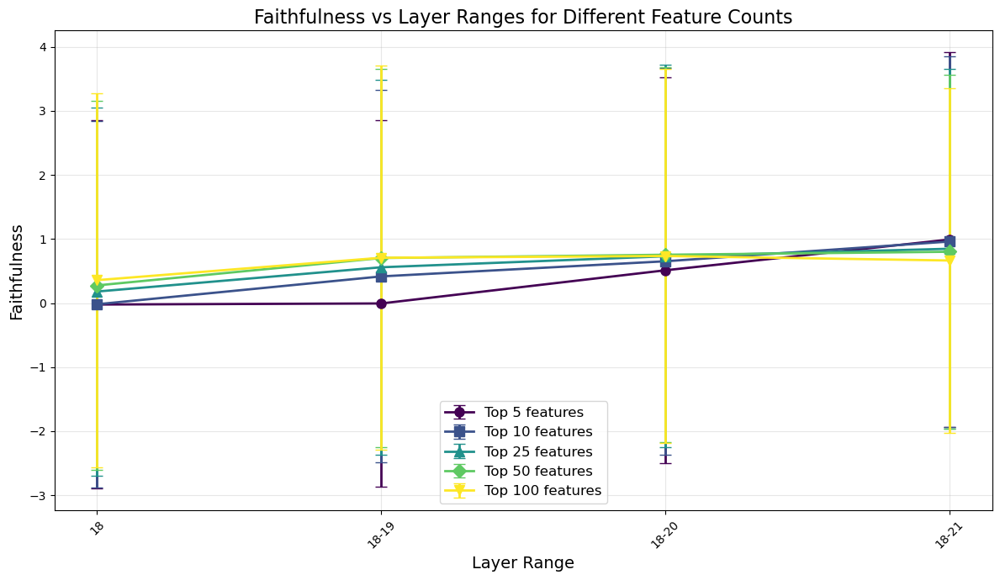

Layer Range Faithfulness Summary:

Layer Range 18-21:
  Top 5 features: 0.9922
  Top 10 features: 0.9609
  Top 25 features: 0.8477
  Top 50 features: 0.8008
  Top 100 features: 0.6641

Layer Range 18-20:
  Top 5 features: 0.5117
  Top 10 features: 0.6523
  Top 25 features: 0.7305
  Top 50 features: 0.7539
  Top 100 features: 0.7344

Layer Range 18-19:
  Top 5 features: -0.0064
  Top 10 features: 0.4160
  Top 25 features: 0.5586
  Top 50 features: 0.7031
  Top 100 features: 0.7070

Layer Range 18:
  Top 5 features: -0.0231
  Top 10 features: -0.0189
  Top 25 features: 0.1797
  Top 50 features: 0.2754
  Top 100 features: 0.3574


In [27]:
plot_faithfulness_vs_layer_ranges(results_df, layers_to_extract)

## Running the ablation & restoration loop (variable upper-layer threshold)

This is a follow-up experiment where we tried to inverstigate how much late error nodes matter by stopping the error node ablation at a specific layer (e.g. ablate error nodes only up to layer 24). More details [here](https://docs.google.com/document/d/1vZrGsoGDEu5MLcL9Iisi0mctW1c-6j37sdSP88GfWaA/edit?tab=t.0#heading=h.xlv8adcign93)

In [25]:
import pandas as pd
from collections import defaultdict

error_layer_thresholds = [21, 22, 23, 24, 25]  # Different thresholds for error node ablation
top_k_value = 50  # Fixed value for top-k features

evaluation_params = {
    'cutoff_early_layers': False,
    'always_ablate_positions': positions_to_select,
    
    'batch_size': 1024,
    'total_batches': None,
    'verbose': False
}

# Initialize data collection structures
results = defaultdict(list)
detailed_results = {}  # For storing comprehensive data that doesn't fit in a dataframe

# Store aggregation settings for consistent display
abs_scores = extraction_params['abs_scores']

In [26]:
# Reset the hooks to avoid weird bugs
sfc_model.model.reset_hooks()
if RUN_WITH_SAES:
    sfc_model._reset_sae_hooks()
clear_cache()

In [27]:
for layer_idx, layer in enumerate(layers_to_extract):
    print(f"\n{'='*80}\nLAYER {layer}\n{'='*80}")
    
    # First, extract the features once (since we're using a fixed top_k)
    selected_nodes_info = circuit_evaluator.sfc_node_scores.get_top_k_features_by_layer(
        layer, 
        top_k_counts=top_k_value,
        verbose=False,  # Turn off built-in verbose output for cleaner display
        **extraction_params
    )
    
    # Unpack the returned data
    feature_indices_dict, maximizing_positions_dict = selected_nodes_info
    
    # Loop over different error layer thresholds
    for threshold in error_layer_thresholds:
        print(f"\n{'-'*60}\nError Layer Threshold {threshold}\n{'-'*60}")
        
        # Create a unique key for this configuration
        config_key = f"layer_{layer}_top_{top_k_value}_error_threshold_{threshold}"
        
        # Define error ablation function for this threshold
        def ablate_error_hook(act_name):
            if 'hook_resid_post.hook_sae_error' not in act_name:
                return False
                
            # Split the input string by periods
            parts = act_name.split('.')
            error_layer_num = int(parts[1])
            
            return error_layer_num <= threshold
        
        # Update evaluation parameters with the current threshold function
        current_eval_params = evaluation_params.copy()
        current_eval_params['nodes_to_always_ablate'] = ablate_error_hook
        
        # Save the detailed feature information
        detailed_results[config_key] = {
            'feature_indices': feature_indices_dict,
            'maximizing_positions': maximizing_positions_dict,
            'layer': layer,
            'top_k': top_k_value,
            'error_threshold': threshold
        }
        
        # Prepare nodes_to_restore and feature_indices_to_restore for circuit evaluation
        nodes_to_restore = list(feature_indices_dict.keys())  # All nodes with selected features
        
        # Evaluate circuit faithfulness
        faithfulness_metrics, n_nodes_in_circuit = circuit_evaluator.evaluate_circuit_faithfulness(
            clean_dataset=clean_dataset,
            patched_dataset=corrupted_dataset,
            nodes_to_restore=nodes_to_restore,
            feature_indices_to_restore=feature_indices_dict,
            **current_eval_params
        )
        
        # Extract useful statistics from faithfulness_metrics
        mean_faithfulness = faithfulness_metrics.mean().item()
        std_faithfulness = faithfulness_metrics.std().item()
        
        # Store all the results
        results['layer'].append(layer)
        results['top_k'].append(top_k_value)
        results['error_threshold'].append(threshold)
        results['num_selected_features'].append(sum(len(indices) for indices in feature_indices_dict.values()))
        results['circuit_size'].append(n_nodes_in_circuit)
        results['mean_faithfulness'].append(mean_faithfulness)
        results['std_faithfulness'].append(std_faithfulness)
        
        # Also collect position statistics
        position_stats = {}
        for node_name, positions in maximizing_positions_dict.items():
            # Convert to numpy array for easier analysis
            pos_array = positions.cpu().numpy()
            position_stats[node_name] = {
                'position_counts': {int(pos): int(count) for pos, count in 
                                   zip(*np.unique(pos_array, return_counts=True))}
            }
        
        detailed_results[config_key]['position_stats'] = position_stats
        
        print(f"Layer {layer}, Error Threshold {threshold}: Mean faithfulness = {mean_faithfulness:.4f}")

### Plotting

In [28]:
# Create DataFrame from the collected results
results_df = pd.DataFrame(results)

# Display the results
print("\nSummary of results:")
print(results_df)

# If needed, convert layer values to proper types
# This handles cases where layer might be a list or the last element of a range
results_df['layer'] = results_df['layer'].apply(lambda x: x if isinstance(x, int) else max(x))

# Save the results for future use
results_df.to_csv(saving_dir / "faithfulness_with_error_thresholds.csv", index=False)

# Save detailed results as pickle
import pickle
with open(saving_dir / "faithfulness_with_error_thresholds_detailed.pkl", "wb") as f:
    pickle.dump(detailed_results, f)

print(f"\nResults saved to 'faithfulness_with_error_thresholds.csv' and 'faithfulness_with_error_thresholds_detailed.pkl' within {saving_dir}")

In [29]:
def plot_faithfulness_heatmap(results_df, layer_ranges=None):
    """
    Create a heatmap showing faithfulness across layer ranges and error thresholds
    
    Args:
        results_df: DataFrame containing results with layer, error_threshold and mean_faithfulness columns
        layer_ranges: Optional list of layer ranges used in the experiment
                      e.g., [[18, 19, 20, 21, 22], [18, 19, 20, 21], ...]
                      If provided, x-axis labels will show ranges instead of just the max layer
    """
    import matplotlib.pyplot as plt
    import seaborn as sns
    import numpy as np
    
    # Extract unique layers and thresholds
    layers = sorted(results_df['layer'].unique())
    thresholds = sorted(results_df['error_threshold'].unique())
    
    # Create a 2D array for the heatmap
    heatmap_data = np.zeros((len(thresholds), len(layers)))
    
    # Fill the heatmap data
    for i, threshold in enumerate(thresholds):
        for j, layer in enumerate(layers):
            # Find the matching row in results_df
            matching_rows = results_df[(results_df['layer'] == layer) & 
                                      (results_df['error_threshold'] == threshold)]
            
            if not matching_rows.empty:
                heatmap_data[i, j] = matching_rows['mean_faithfulness'].iloc[0]
    
    # Create x-axis labels
    if layer_ranges is not None:
        # Create a mapping from max layer to range label
        layer_to_label = {}
        for layer_range in layer_ranges:
            max_layer = max(layer_range)
            if len(layer_range) > 1:
                label = f"{min(layer_range)}-{max(layer_range)}"
            else:
                label = str(layer_range[0])
            layer_to_label[max_layer] = label
        
        # Apply mapping to get labels in the correct order
        x_labels = [layer_to_label.get(layer, str(layer)) for layer in layers]
    else:
        x_labels = [str(layer) for layer in layers]
    
    # Create figure
    plt.figure(figsize=(12, 8))
    
    # Create the heatmap
    ax = sns.heatmap(heatmap_data, annot=True, fmt=".3f", cmap="viridis", 
                    xticklabels=x_labels, yticklabels=thresholds,
                    vmin=0, vmax=1.0, cbar_kws={'label': 'Faithfulness'})
    
    # Customize the plot
    plt.xlabel('Layer Range (Max Layer)', fontsize=12)
    plt.ylabel('Error Layer Threshold', fontsize=12)
    plt.title('Faithfulness Across Layer Ranges and Error Thresholds', fontsize=14)
    
    # Rotate x-axis labels if needed
    plt.xticks(rotation=45)
    
    # Adjust layout and save
    plt.tight_layout()
    plt.savefig('faithfulness_heatmap.png', dpi=300)
    plt.show()
    
    # Print summary of best configurations
    print("Top 5 configurations by faithfulness:")
    flat_data = []
    for i, threshold in enumerate(thresholds):
        for j, layer in enumerate(layers):
            flat_data.append({
                'layer': layers[j],
                'error_threshold': thresholds[i],
                'faithfulness': heatmap_data[i, j],
                'label': f"Layer {x_labels[j]}, Error Threshold {thresholds[i]}"
            })
    
    # Sort by faithfulness and display top 5
    flat_data.sort(key=lambda x: x['faithfulness'], reverse=True)
    for i, config in enumerate(flat_data[:5]):
        print(f"{i+1}. {config['label']}: {config['faithfulness']:.4f}")
    
    return heatmap_data, x_labels, thresholds

In [30]:
# Plot the heatmap
heatmap_data, x_labels, thresholds = plot_faithfulness_heatmap(results_df, layers_to_extract)

## Sliding window ablation

This is a follow-up experiment aimed to understand how much ablation of contiguous subset of error node matters compared to ablating 14-17 error nodes from above. More details [here](https://docs.google.com/document/d/1vZrGsoGDEu5MLcL9Iisi0mctW1c-6j37sdSP88GfWaA/edit?tab=t.0#heading=h.w5rrs58232s)

In [ ]:
import pandas as pd
from collections import defaultdict

# Define ranges for error layers to test
error_layers_to_ablate = list(range(26))  # From 0 to 25

evaluation_params = {
    'cutoff_early_layers': False,
    'always_ablate_positions': positions_to_select,
    
    'batch_size': 1024,
    'total_batches': None,
    'verbose': True
}

# Initialize data collection structures
results = defaultdict(list)

In [32]:
# Reset the hooks to avoid weird bugs
sfc_model.model.reset_hooks()
if RUN_WITH_SAES:
    sfc_model._reset_sae_hooks()
clear_cache()

In [33]:
# Define window parameters
window_width = 4  # Initial window of 0-3
window_step = 1
max_right_bound = error_layers_to_ablate[-1]

# Initialize results
results = {
    'window_left': [],
    'window_right': [],
    'mean_faithfulness': [],
    'std_faithfulness': []
}

# Loop over sliding windows of error layers to ablate
window_left = error_layers_to_ablate[0]
window_right = window_width - 1

while window_right <= max_right_bound:
    print(f"\n{'-'*60}\nAblating Error Layers {window_left} to {window_right}\n{'-'*60}")
    
    # Define error ablation function for this window of error layers
    def ablate_error_hook(act_name):
        if 'hook_resid_post.hook_sae_error' not in act_name:
            return False
        
        # Split the input string by periods
        parts = act_name.split('.')
        error_layer_num = int(parts[1])
        
        # Ablate if the error layer is within the current window
        return window_left <= error_layer_num <= window_right
    
    # Update evaluation parameters with the current window ablation function
    current_eval_params = evaluation_params.copy()
    current_eval_params['nodes_to_always_ablate'] = ablate_error_hook
    
    # Evaluate circuit faithfulness
    faithfulness_metrics, n_nodes_in_circuit = circuit_evaluator.evaluate_circuit_faithfulness(
        clean_dataset=clean_dataset,
        patched_dataset=corrupted_dataset,
        **current_eval_params
    )
    
    # Extract useful statistics from faithfulness_metrics
    mean_faithfulness = faithfulness_metrics.mean().item()
    std_faithfulness = faithfulness_metrics.std().item()
    
    # Store all the results
    results['window_left'].append(window_left)
    results['window_right'].append(window_right)
    results['mean_faithfulness'].append(mean_faithfulness)
    results['std_faithfulness'].append(std_faithfulness)
    
    print(f"Layer {layer}, Error Layers {window_left}-{window_right}: Mean faithfulness = {mean_faithfulness:.4f}")
    
    # Slide the window by the step size
    window_left += window_step
    window_right += window_step


------------------------------------------------------------
Ablating Error Layers 0 to 3
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.0.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.1.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 0-3: Mean faithfulness = 0.9929

------------------------------------------------------------
Ablating Error Layers 1 to 4
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.1.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 1-4: Mean faithfulness = 1.0297

------------------------------------------------------------
Ablating Error Layers 2 to 5
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.2.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 2-5: Mean faithfulness = 1.0114

------------------------------------------------------------
Ablating Error Layers 3 to 6
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.3.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 3-6: Mean faithfulness = 0.9883

------------------------------------------------------------
Ablating Error Layers 4 to 7
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.4.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 4-7: Mean faithfulness = 0.9308

------------------------------------------------------------
Ablating Error Layers 5 to 8
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.5.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 5-8: Mean faithfulness = 0.9043

------------------------------------------------------------
Ablating Error Layers 6 to 9
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.6.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 6-9: Mean faithfulness = 0.8829

------------------------------------------------------------
Ablating Error Layers 7 to 10
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.7.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 7-10: Mean faithfulness = 0.8723

------------------------------------------------------------
Ablating Error Layers 8 to 11
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.8.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 8-11: Mean faithfulness = 0.8438

------------------------------------------------------------
Ablating Error Layers 9 to 12
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.9.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 9-12: Mean faithfulness = 0.8173

------------------------------------------------------------
Ablating Error Layers 10 to 13
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.10.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 10-13: Mean faithfulness = 0.8090

------------------------------------------------------------
Ablating Error Layers 11 to 14
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.11.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 11-14: Mean faithfulness = 0.7570

------------------------------------------------------------
Ablating Error Layers 12 to 15
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.12.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 12-15: Mean faithfulness = 0.7396

------------------------------------------------------------
Ablating Error Layers 13 to 16
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.13.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.16.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 13-16: Mean faithfulness = 0.6764

------------------------------------------------------------
Ablating Error Layers 14 to 17
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.14.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.15.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.16.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.17.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 14-17: Mean faithfulness = 0.5641

------------------------------------------------------------
Ablating Error Layers 15 to 18
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.15.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.16.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.17.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.18.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 15-18: Mean faithfulness = 0.5984

------------------------------------------------------------
Ablating Error Layers 16 to 19
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.16.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.17.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.18.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.19.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 16-19: Mean faithfulness = 0.6419

------------------------------------------------------------
Ablating Error Layers 17 to 20
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.17.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.18.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.19.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.20.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 17-20: Mean faithfulness = 0.7189

------------------------------------------------------------
Ablating Error Layers 18 to 21
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.18.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.19.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.20.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.21.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 18-21: Mean faithfulness = 0.8845

------------------------------------------------------------
Ablating Error Layers 19 to 22
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.19.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.20.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.21.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.22.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 19-22: Mean faithfulness = 1.0062

------------------------------------------------------------
Ablating Error Layers 20 to 23
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.20.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.21.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.22.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.23.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 20-23: Mean faithfulness = 1.0640

------------------------------------------------------------
Ablating Error Layers 21 to 24
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.21.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.22.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.23.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.24.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 21-24: Mean faithfulness = 1.1128

------------------------------------------------------------
Ablating Error Layers 22 to 25
------------------------------------------------------------
Restoring 0 nodes.


  0%|          | 0/10 [00:00<?, ?it/s]

Ablating blocks.22.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.23.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.24.hook_resid_post.hook_sae_error in 2 positions
Ablating blocks.25.hook_resid_post.hook_sae_error in 2 positions
Layer [18], Error Layers 22-25: Mean faithfulness = 1.0334


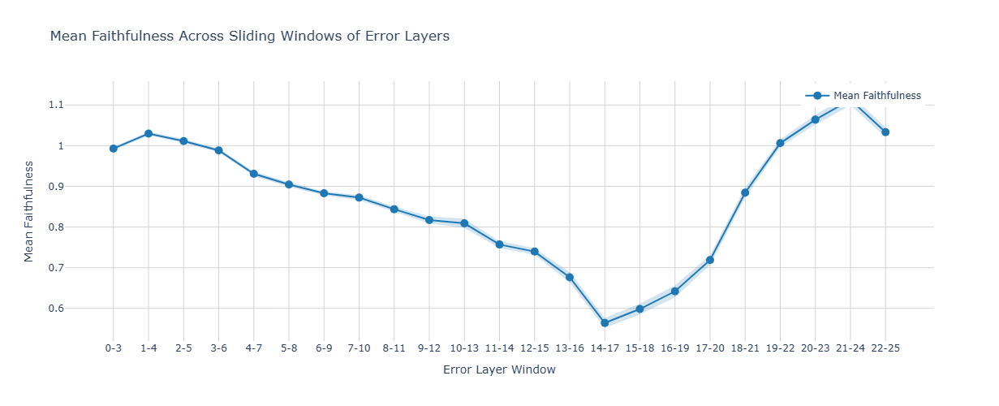


Summary of Results:
--------------------------------------------------------------------------------
Window         Mean Faithfulness   Std Faithfulness
--------------------------------------------------------------------------------
0-3            0.9929              0.0040
1-4            1.0297              0.0048
2-5            1.0114              0.0047
3-6            0.9883              0.0043
4-7            0.9308              0.0054
5-8            0.9043              0.0060
6-9            0.8829              0.0048
7-10           0.8723              0.0064
8-11           0.8438              0.0070
9-12           0.8173              0.0088
10-13          0.8090              0.0115
11-14          0.7570              0.0088
12-15          0.7396              0.0081
13-16          0.6764              0.0132
14-17          0.5641              0.0122
15-18          0.5984              0.0133
16-19          0.6419              0.0148
17-20          0.7189              0.0120
18-21    

In [34]:
import plotly.graph_objects as go
import numpy as np
import pandas as pd

# Create a DataFrame for easier plotting with Plotly
df = pd.DataFrame({
    'Window Left': results['window_left'],
    'Window Right': results['window_right'],
    'Mean Faithfulness': results['mean_faithfulness'],
    'Std Faithfulness': results['std_faithfulness']
})

# Create window labels for the x-axis (e.g., "0-3", "1-4", etc.)
df['Window Label'] = df.apply(lambda row: f"{int(row['Window Left'])}-{int(row['Window Right'])}", axis=1)

# Calculate window midpoints for plotting
df['Window Midpoint'] = (df['Window Left'] + df['Window Right']) / 2

# Create the figure
fig = go.Figure()

# Add the line and markers
fig.add_trace(go.Scatter(
    x=df['Window Midpoint'],
    y=df['Mean Faithfulness'],
    mode='lines+markers',
    name='Mean Faithfulness',
    line=dict(color='#1f77b4', width=2),
    marker=dict(size=10, color='#1f77b4'),
))

# Add error bars
fig.add_trace(go.Scatter(
    x=np.concatenate([df['Window Midpoint'], df['Window Midpoint'][::-1]]),
    y=np.concatenate([
        df['Mean Faithfulness'] + df['Std Faithfulness'],
        (df['Mean Faithfulness'] - df['Std Faithfulness'])[::-1]
    ]),
    fill='toself',
    fillcolor='rgba(31, 119, 180, 0.2)',
    line=dict(color='rgba(255, 255, 255, 0)'),
    hoverinfo='skip',
    showlegend=False
))

# Customize the layout
fig.update_layout(
    title='Mean Faithfulness Across Sliding Windows of Error Layers',
    xaxis=dict(
        title='Error Layer Window',
        tickmode='array',
        tickvals=df['Window Midpoint'],
        ticktext=df['Window Label'],
        gridcolor='lightgray'
    ),
    yaxis=dict(
        title='Mean Faithfulness',
        gridcolor='lightgray'
    ),
    hovermode='x unified',
    template='plotly_white',
    width=900,
    height=500,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    )
)

# Add custom hover text with more information
hover_text = [f"Window: {left}-{right}<br>Mean Faithfulness: {mean:.4f}<br>Std Deviation: {std:.4f}" 
              for left, right, mean, std in zip(
                  df['Window Left'], df['Window Right'], 
                  df['Mean Faithfulness'], df['Std Faithfulness']
              )]
fig.data[0].hovertext = hover_text
fig.data[0].hoverinfo = "text"

# Show the figure
fig.show()

# Print a summary table of the results
print("\nSummary of Results:")
print("-" * 80)
print(f"{'Window':<15}{'Mean Faithfulness':<20}{'Std Faithfulness'}")
print("-" * 80)
for i in range(len(df)):
    print(f"{df['Window Label'].iloc[i]:<15}{df['Mean Faithfulness'].iloc[i]:<20.4f}{df['Std Faithfulness'].iloc[i]:.4f}")

# Results analysis

## Looking at which token positions contain the most important features

In [71]:
# Sanity check: make sure I can reproduce the same top-k ranking as returned by the get_top_k_features_by_layer
LAYER = 18
act_to_check = f'blocks.{LAYER}.hook_resid_post.hook_sae_acts_post'

resid_latents = circuit_evaluator.sfc_node_scores.select_node_scores(lambda act: act == act_to_check)[act_to_check]

In [72]:
# POSITIONS = np.array(range(8))
POSITIONS = np.array([2, 6])
SELECT_K = 100
PRINT_K = 10

resid_latents_agg, maximizing_tok_positions = resid_latents[POSITIONS].max(dim=0)

top_values, top_features = resid_latents_agg.topk(SELECT_K)

for i in range(PRINT_K):
    print(f'Feature #{top_features[i]} with score = {top_values[i]:.6f} selected from position {POSITIONS[maximizing_tok_positions[top_features[i]]]}')

Feature #10665 with score = 0.020020 selected from position 6
Feature #1506 with score = 0.006042 selected from position 2
Feature #4442 with score = 0.002594 selected from position 6
Feature #15377 with score = 0.001610 selected from position 2
Feature #1271 with score = 0.001534 selected from position 2
Feature #11484 with score = 0.001450 selected from position 6
Feature #9777 with score = 0.000946 selected from position 6
Feature #9525 with score = 0.000843 selected from position 6
Feature #1495 with score = 0.000614 selected from position 6
Feature #11381 with score = 0.000614 selected from position 6


This is consistent with the output we got from the `get_top_k_features_by_layer` method if you scroll above.

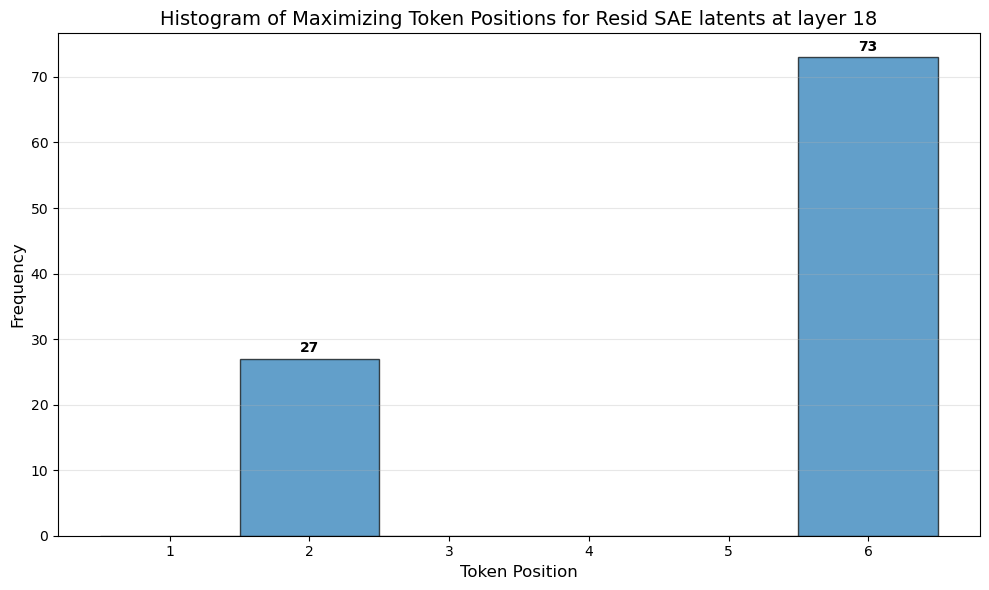

Position 2: 27 features (27.0%)
Position 6: 73 features (73.0%)


In [73]:
import matplotlib.pyplot as plt
import numpy as np
import torch

# Move tensor to CPU and convert to numpy for plotting
positions = POSITIONS[maximizing_tok_positions[top_features].cpu().numpy()]

# Create the histogram
plt.figure(figsize=(10, 6))
counts, bins, patches = plt.hist(positions, bins=np.arange(0.5, max(positions)+1.5, 1), 
                                 edgecolor='black', alpha=0.7)

# Add count labels on top of each bar
for i, count in enumerate(counts):
    if count > 0:
        plt.text(bins[i] + 0.5, count + 0.5, str(int(count)), 
                 ha='center', va='bottom', fontweight='bold')

# Customize the plot
plt.title(f'Histogram of Maximizing Token Positions for Resid SAE latents at layer {LAYER}', fontsize=14)
plt.xlabel('Token Position', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(range(1, int(max(positions))+1))
plt.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

# Print counts for each position
unique_positions, position_counts = np.unique(positions, return_counts=True)
for pos, count in zip(unique_positions, position_counts):
    percentage = 100 * count / len(positions)
    print(f"Position {int(pos)}: {count} features ({percentage:.1f}%)")

The distribution of maximizing positions for our top K features is also the same as we got from `get_top_k_features_by_layer`.

## Setup x2 for running the notebook from this section (don't read)

In [92]:
from IPython import get_ipython # type: ignore
ipython = get_ipython(); assert ipython is not None
ipython.run_line_magic("load_ext", "autoreload")
ipython.run_line_magic("autoreload", "2")

# Standard imports
import os
import torch
import numpy as np
from tqdm import tqdm
import plotly.express as px
import pandas as pd
import einops
from jaxtyping import Float, Int
from torch import Tensor

torch.set_grad_enabled(False)

# Device setup
GPU_TO_USE = 3

if torch.backends.mps.is_available():
    device = "mps"
else:
    device = f"cuda:{GPU_TO_USE}" if torch.cuda.is_available() else "cpu"

print(f"Device: {device}")

# utility to clear variables out of the memory & and clearing cuda cache
import gc
def clear_cache():
    gc.collect()
    torch.cuda.empty_cache()

from pathlib import Path
import sys
import os

def get_base_folder(parent_dir_name =  "tim-taras-sfc-errors"):
	# Find the project root dynamically
	current_dir = os.getcwd()
	while True:
		if os.path.basename(current_dir) == parent_dir_name:  # Adjust to match your project root folder name
			break
		parent = os.path.dirname(current_dir)
		if parent == current_dir:  # Stop if we reach the system root (failsafe)
			raise RuntimeError(f"Project root {parent_dir_name} not found. Check your folder structure.")
		current_dir = parent

	return current_dir

def get_data_path(base_folder=None, data_folder_name='data'):
	if base_folder is None:
		base_folder = get_base_folder()

	return Path(base_folder) / data_folder_name

def get_project_folder(base_folder=None, project_folder_name='sfc-errors'):
	if base_folder is None:
		base_folder = get_base_folder()
	
	return Path(base_folder) / project_folder_name

base_path = get_base_folder()
print(f"Base path: {base_path}")

project_path = get_project_folder(base_folder=base_path)
print(f"Project path: {project_path}")

# Add the parent directory (sfc_deception) to sys.path
sys.path.append(base_path)
sys.path.append(str(project_path))

datapath = get_data_path(base_path) 
datapath

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Device: cuda:3
Base path: /mnt/ssd-1/mechinterp/taras/tim-taras-sfc-errors
Project path: /mnt/ssd-1/mechinterp/taras/tim-taras-sfc-errors/sfc-errors


PosixPath('/mnt/ssd-1/mechinterp/taras/tim-taras-sfc-errors/data')

## Plots

### Comparing restoration of all resid error nodes vs 14-17 error nodes

Load the two csv files with results of the standard ablation experiment (ablate all error nodes) with the results of "ablate 14-17 error nodes" experiment

In [30]:
# Load the CSV files with our metrics
EXPERIMENT = 'sva_rc_test'

standard_results_df = pd.read_csv(datapath / EXPERIMENT / "faithfulness_with_different_topk.csv")
modified_results_df = pd.read_csv(datapath / EXPERIMENT / "faithfulness_with_different_topk_layers_14_17_ablated.csv")

In [31]:
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import pandas as pd
from plotly.subplots import make_subplots

def plot_compare_faithfulness_vs_layer_ranges(results, results_modified, modified_title='modified', baseline=0):
    """
    Plot faithfulness vs layer ranges for both original and modified results using Plotly.
    This version omits error bars/bands and focuses on clean line visualization.
    Uncertainty information is reported in the printed summary table instead.
    
    Args:
        results: DataFrame containing the original results with integer 'layer' column
        results_modified: DataFrame containing the modified results with the same structure
        modified_title: String to describe the modified results in legends and labels (default: 'modified')
        baseline: Fixed value to subtract from all modified faithfulness scores (default: 0)
    """
    # Get unique layer values and top_k values
    all_layers = pd.concat([results['layer'], results_modified['layer']]).unique()
    top_k_values = sorted(results['top_k'].unique())
    
    # Sort layers
    all_layers = sorted(all_layers)
    
    # Create figure
    fig = go.Figure()
    
    # Set default Plotly colors
    colors = px.colors.qualitative.Plotly
    
    # For each top_k value, plot a line showing faithfulness vs layer range
    for i, k in enumerate(top_k_values):
        color = colors[i % len(colors)]  # Cycle through Plotly colors
        
        # Process original results
        k_data_orig = results[results['top_k'] == k]
        # Process modified results
        k_data_mod = results_modified[results_modified['top_k'] == k]
        
        # Prepare data points for plotting original results
        x_positions_orig = []
        y_values_orig = []
        hover_texts_orig = []
        
        # Prepare data points for plotting modified results
        x_positions_mod = []
        y_values_mod = []
        hover_texts_mod = []
        
        # Process each layer
        for layer in all_layers:
            # Find the corresponding row in original results
            matching_rows_orig = k_data_orig[k_data_orig['layer'] == layer]
            
            if not matching_rows_orig.empty:
                # Get the first matching row
                row = matching_rows_orig.iloc[0]
                
                x_positions_orig.append(layer)
                y_values_orig.append(row['mean_faithfulness'])
                
                # Create hover text with additional information
                hover_text = f"Layer: {layer}<br>"
                hover_text += f"Top K: {k}<br>"
                hover_text += f"Mean Faithfulness: {row['mean_faithfulness']:.4f}<br>"
                hover_text += f"Std Deviation: {row.get('std_faithfulness', 0):.4f}<br>"
                hover_text += f"Selected Features: {row['num_selected_features']}"
                hover_texts_orig.append(hover_text)
            
            # Find the corresponding row in modified results
            matching_rows_mod = k_data_mod[k_data_mod['layer'] == layer]
            
            if not matching_rows_mod.empty:
                # Get the first matching row
                row = matching_rows_mod.iloc[0]
                
                # Subtract baseline from modified faithfulness score and normalize
                if np.abs(baseline) > 1e-3:
                    modified_faithfulness = (row['mean_faithfulness'] - baseline) / (1 - baseline)
                else:
                    modified_faithfulness = row['mean_faithfulness']
                
                x_positions_mod.append(layer)
                y_values_mod.append(modified_faithfulness)
                
                # Create hover text with additional information
                hover_text = f"Layer: {layer}<br>"
                hover_text += f"Top K: {k}<br>"
                hover_text += f"Mean Faithfulness: {modified_faithfulness:.4f}<br>"
                hover_text += f"Original Value: {row['mean_faithfulness']:.4f}<br>"
                hover_text += f"Std Deviation: {row.get('std_faithfulness', 0):.4f}<br>"
                hover_text += f"Baseline: {baseline}<br>"
                if np.abs(baseline) > 1e-3:
                    hover_text += f"Normalization: (value - {baseline}) / (1 - {baseline})<br>"
                hover_text += f"Selected Features: {row['num_selected_features']}"
                hover_texts_mod.append(hover_text)
        
        # Plot original results
        if x_positions_orig:
            fig.add_trace(go.Scatter(
                x=x_positions_orig,
                y=y_values_orig,
                mode='lines+markers',
                line=dict(color=color, width=2),
                marker=dict(color=color, size=10, symbol='circle'),
                name=f'Original Top {k}',
                legendgroup=f'group{k}',
                hovertext=hover_texts_orig,
                hoverinfo='text'
            ))
            
        # Plot modified results with dashed lines but same color
        if x_positions_mod:
            fig.add_trace(go.Scatter(
                x=x_positions_mod,
                y=y_values_mod,
                mode='lines+markers',
                line=dict(color=color, width=2, dash='dash'),
                marker=dict(color=color, size=10, symbol='square'),
                name=f'Top {k} when {modified_title}',
                legendgroup=f'group{k}',
                hovertext=hover_texts_mod,
                hoverinfo='text'
            ))
    
    # Customize the layout
    fig.update_layout(
        title={
            'text': 'Comparison of Faithfulness vs Layer Ranges for Different Feature Counts',
            'y': 0.95,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'
        },
        xaxis=dict(
            title='Layer',
            gridcolor='lightgray'
        ),
        yaxis=dict(
            title='Faithfulness',
            gridcolor='lightgray',
            range=[max(-0.05, min(min(results['mean_faithfulness']), min(results_modified['mean_faithfulness'] - baseline)) - 0.05), 
                   1.05]  # Dynamic range starting from slightly below min value
        ),
        hovermode='closest',
        template='plotly_white',
        width=1000,
        height=600,
        # Move legend below the plot
        legend=dict(
            orientation='h',
            y=-0.15,  # Position below the plot
            x=0.5,
            xanchor='center',
            yanchor='top',
            font=dict(size=10)
        ),
        # Add more margin at the bottom to make room for the legend
        margin=dict(b=100)
    )
    
    # Add a note about baseline adjustment if applicable
    if np.abs(baseline) > 1e-3:
        fig.add_annotation(
            x=0.5,
            y=1.05,
            xref="paper",
            yref="paper",
            text=f"Note: {modified_title} results normalized as (value - {baseline}) / (1 - {baseline})",
            showarrow=False,
            font=dict(size=12, color="gray"),
            align="center"
        )
    
    # Show the figure
    fig.show()
    
    # Create a nicely formatted DataFrame for display
    summary_data = []
    
    for layer in all_layers:
        for k in top_k_values:
            orig_rows = results[(results['layer'] == layer) & (results['top_k'] == k)]
            mod_rows = results_modified[(results_modified['layer'] == layer) & (results_modified['top_k'] == k)]
            
            if not orig_rows.empty and not mod_rows.empty:
                orig_mean = orig_rows['mean_faithfulness'].iloc[0]
                orig_std = orig_rows.get('std_faithfulness', pd.Series([0])).iloc[0]
                orig_features = orig_rows['num_selected_features'].iloc[0]
                
                mod_raw_mean = mod_rows['mean_faithfulness'].iloc[0]
                mod_std = mod_rows.get('std_faithfulness', pd.Series([0])).iloc[0]
                mod_features = mod_rows['num_selected_features'].iloc[0]
                
                # Apply the same normalization as in the plot
                if np.abs(baseline) > 1e-3:
                    mod_adjusted_mean = (mod_raw_mean - baseline) / (1 - baseline)
                else:
                    mod_adjusted_mean = mod_raw_mean
                    
                diff = mod_adjusted_mean - orig_mean
                pct_change = (diff / orig_mean) * 100 if orig_mean != 0 else float('inf')
                
                # Add row to summary data
                summary_data.append({
                    'Layer': layer,
                    'Top K': k,
                    'Original Mean': orig_mean,
                    'Original Std': orig_std,
                    'Original Features': orig_features,
                    f'{modified_title.title()} Mean': mod_adjusted_mean,
                    f'{modified_title.title()} Std': mod_std,
                    f'{modified_title.title()} Features': mod_features,
                    'Difference': diff,
                    'Percent Change': f"{pct_change:.2f}%"
                })
    
    # Create DataFrame and set display options
    summary_df = pd.DataFrame(summary_data)
    
    # Configure pandas display options for better formatting
    pd.set_option('display.precision', 4)
    pd.set_option('display.max_columns', None)
    pd.set_option('display.width', None)
    pd.set_option('display.float_format', '{:.4f}'.format)
    
    print("\nDetailed Results Summary:")
    print(summary_df)
    
    # Reset pandas display options
    pd.reset_option('display.precision')
    pd.reset_option('display.max_columns')
    pd.reset_option('display.width')
    pd.reset_option('display.float_format')

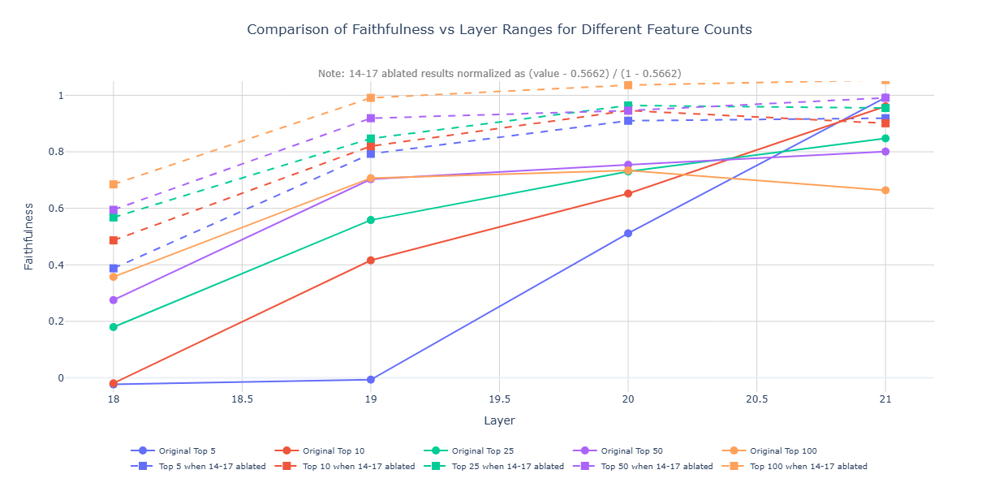


Detailed Results Summary:
    Layer  Top K  Original Mean  Original Std  Original Features  \
0      18      5        -0.0231        2.8750                 15   
1      18     10        -0.0189        2.8594                 30   
2      18     25         0.1797        2.8750                 75   
3      18     50         0.2754        2.8750                150   
4      18    100         0.3574        2.9219                300   
5      19      5        -0.0064        2.8594                 30   
6      19     10         0.4160        2.9062                 60   
7      19     25         0.5586        2.9219                150   
8      19     50         0.7031        2.9531                300   
9      19    100         0.7070        3.0000                600   
10     20      5         0.5117        3.0156                 45   
11     20     10         0.6523        3.0156                 90   
12     20     25         0.7305        2.9844                225   
13     20     50     

In [32]:
plot_compare_faithfulness_vs_layer_ranges(standard_results_df, modified_results_df, 
                                          modified_title='14-17 ablated', baseline=0.5662)

### Plotting histograms of faithfulness scores

Load the tensors of faithfulness scores for each sample and plot the resulting distribution

In [28]:
layers_to_plot = [
    # [18, 19, 20, 21, 22, 23, 24, 25],
    # [18, 19, 20, 21, 22, 23, 24],
    # [18, 19, 20, 21, 22, 23],
    # [18, 19, 20, 21, 22],
    [18, 19, 20, 21],
    [18, 19, 20],
    [18, 19],
    [18]
]
top_k_to_plot = [5, 10, 25, 50, 100]


LAYER [18, 19, 20, 21]

------------------------------------------------------------
Top 5 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


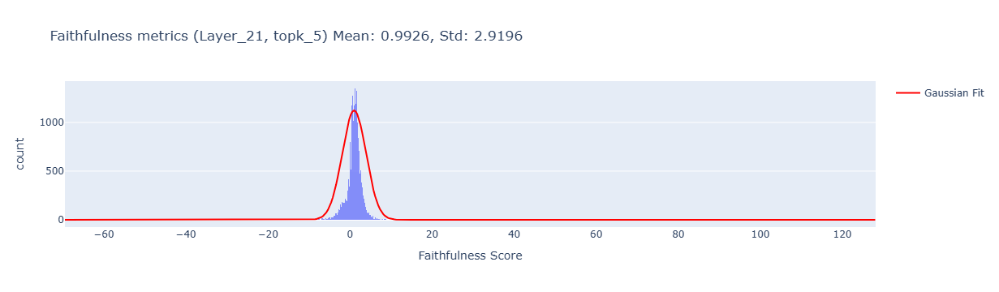


------------------------------------------------------------
Top 10 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


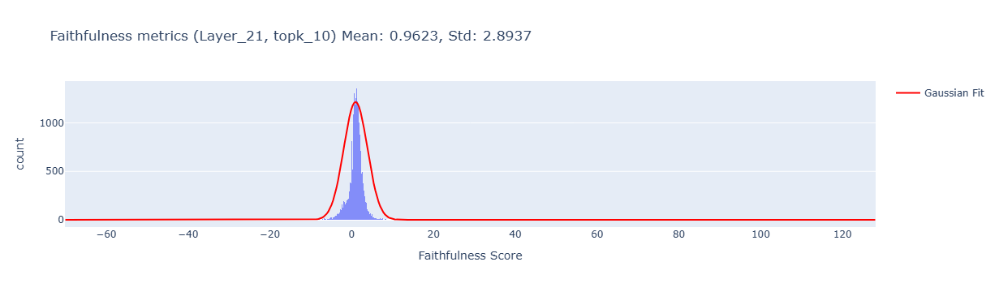


------------------------------------------------------------
Top 25 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


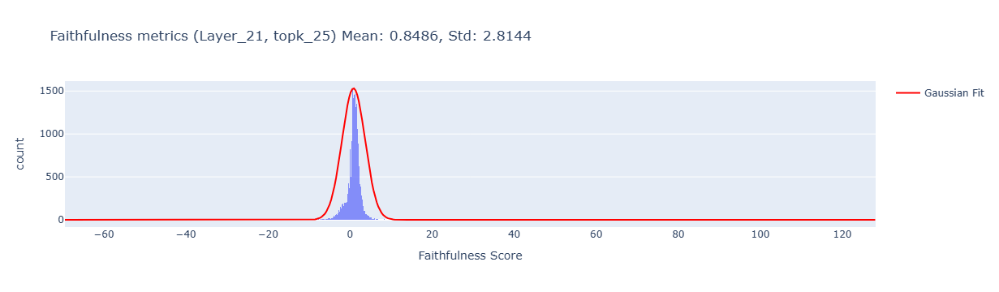


------------------------------------------------------------
Top 50 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


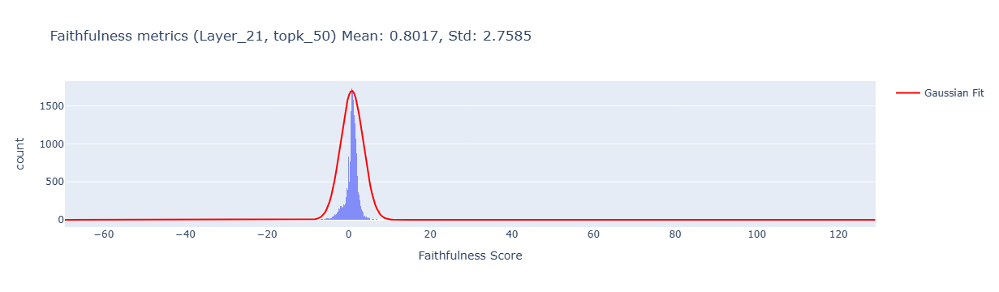


------------------------------------------------------------
Top 100 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


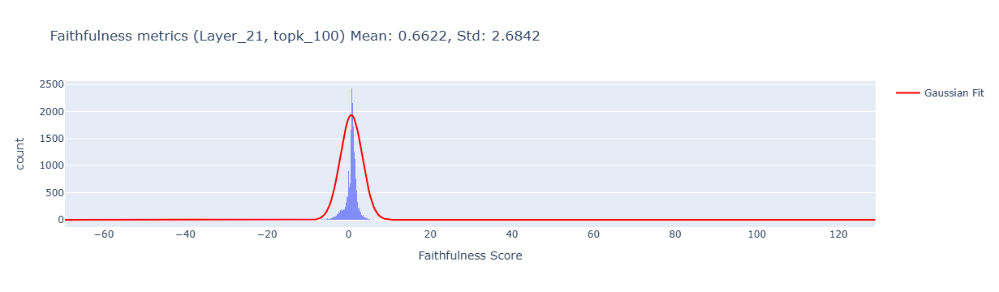


LAYER [18, 19, 20]

------------------------------------------------------------
Top 5 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


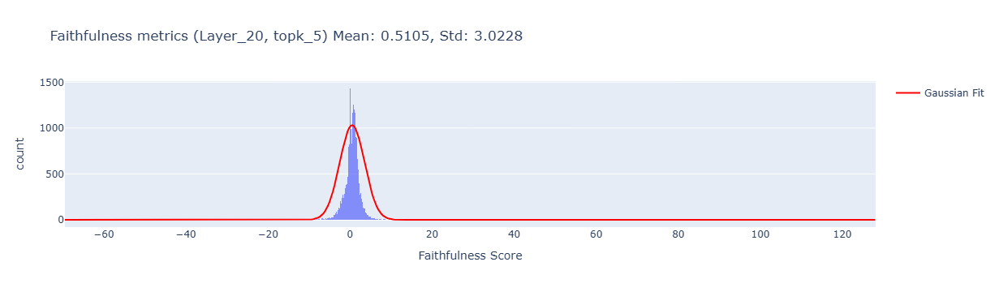


------------------------------------------------------------
Top 10 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


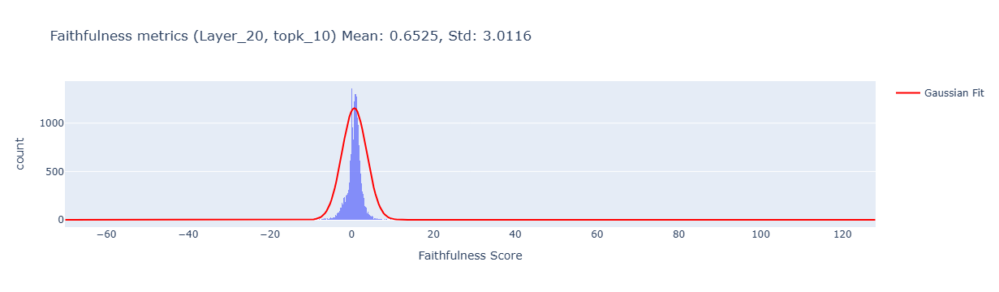


------------------------------------------------------------
Top 25 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


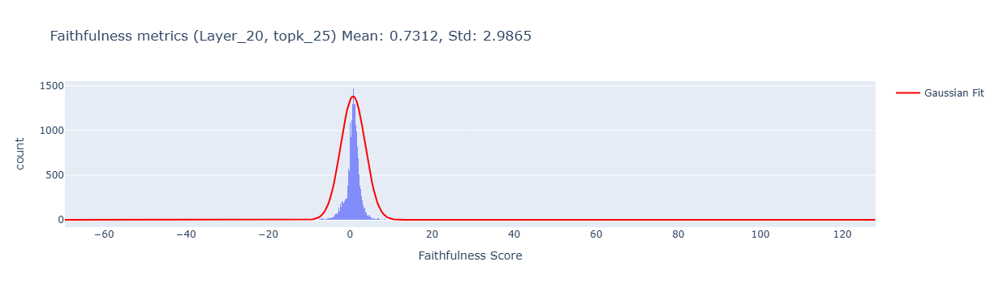


------------------------------------------------------------
Top 50 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


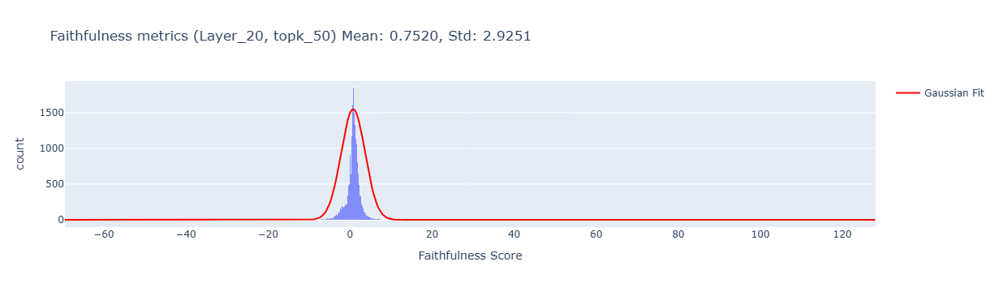


------------------------------------------------------------
Top 100 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


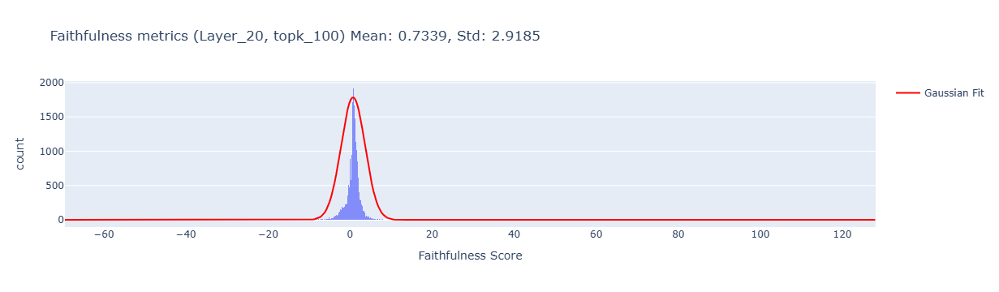


LAYER [18, 19]

------------------------------------------------------------
Top 5 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


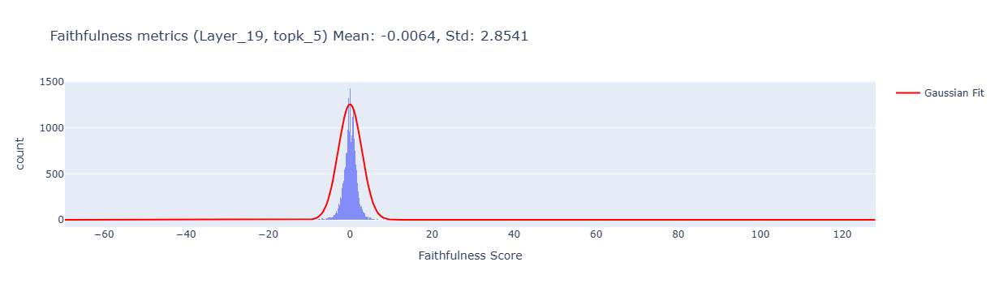


------------------------------------------------------------
Top 10 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


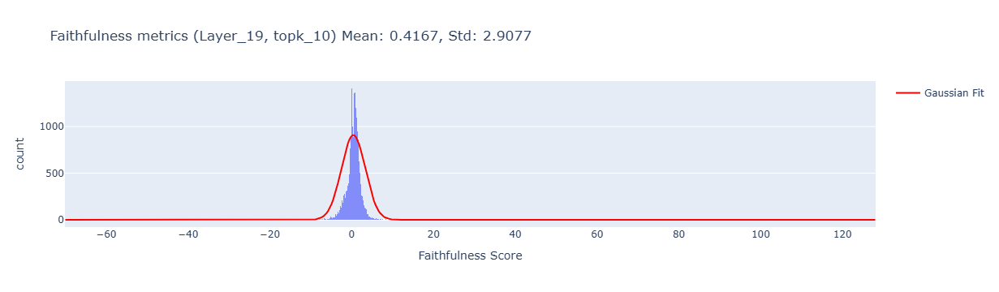


------------------------------------------------------------
Top 25 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


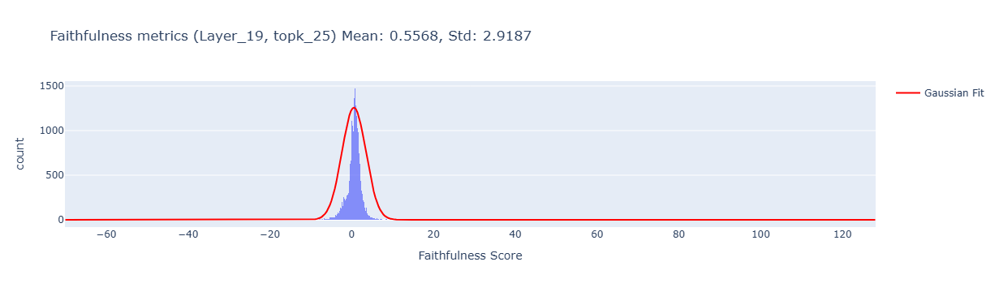


------------------------------------------------------------
Top 50 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


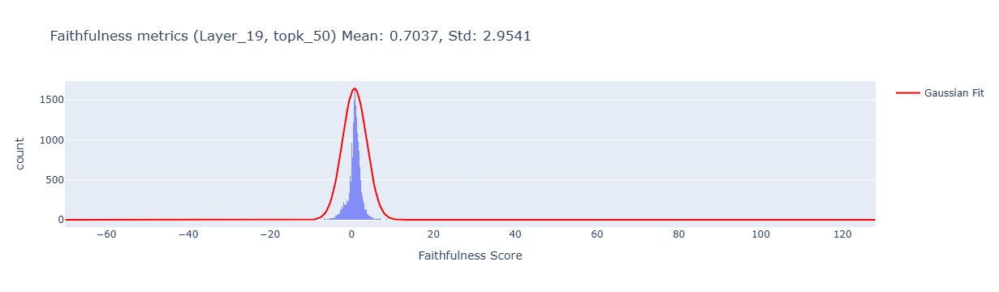


------------------------------------------------------------
Top 100 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


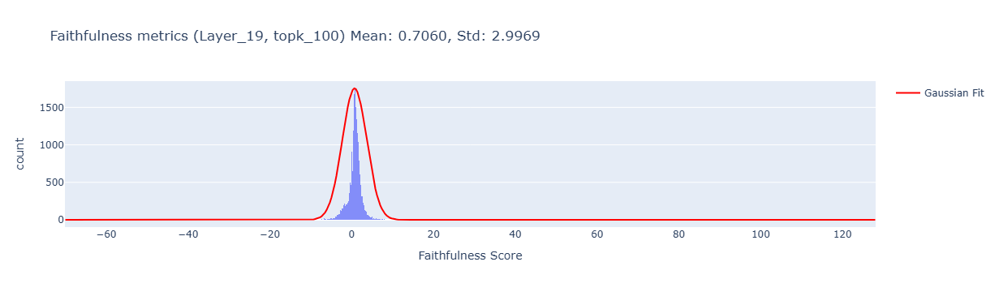


LAYER [18]

------------------------------------------------------------
Top 5 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


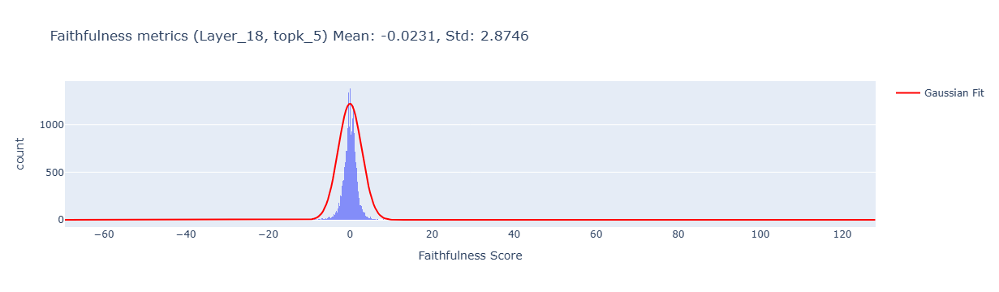


------------------------------------------------------------
Top 10 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


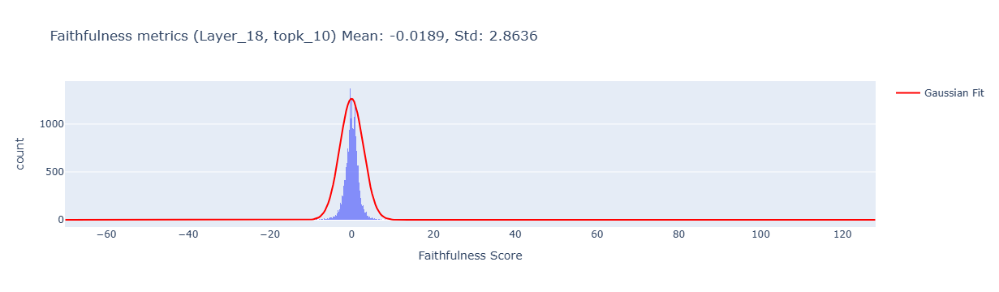


------------------------------------------------------------
Top 25 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


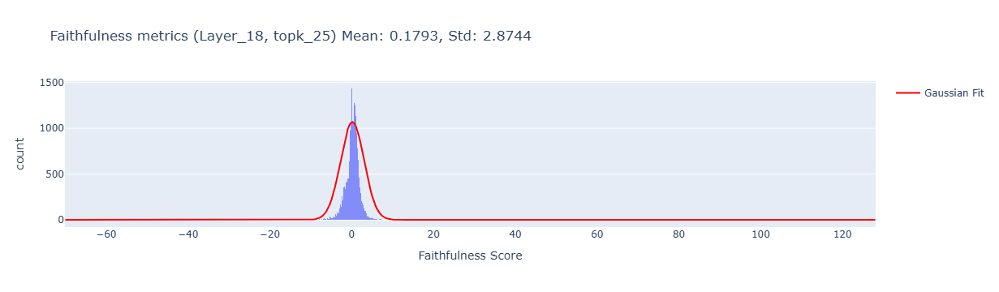


------------------------------------------------------------
Top 50 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


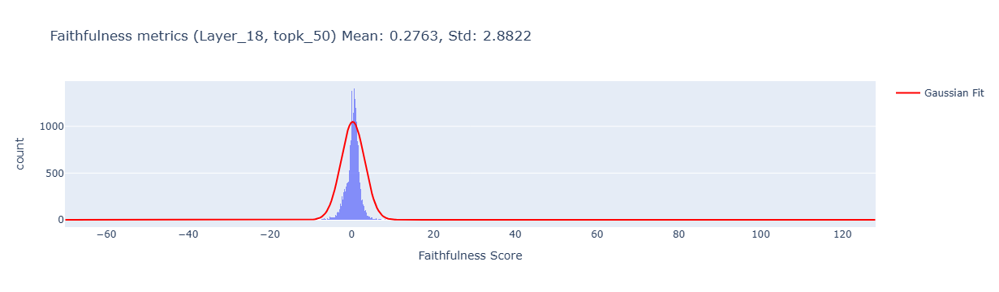


------------------------------------------------------------
Top 100 features
------------------------------------------------------------
Filtered metrics shape: (19120,)
Original metrics shape: torch.Size([19138])


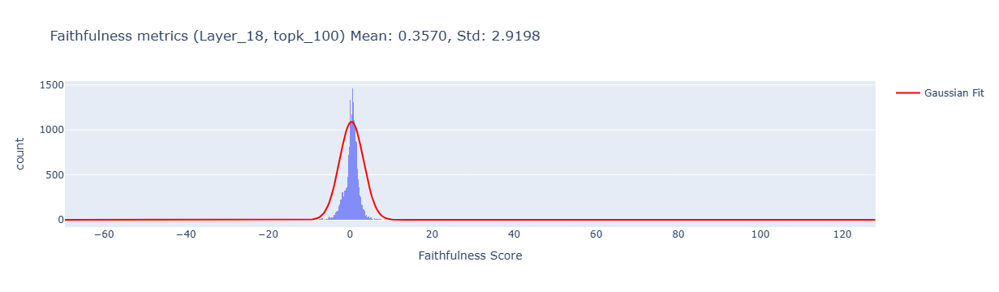

In [29]:
import torch
import plotly.express as px
import plotly.graph_objects as go
import pandas as pd
import numpy as np
from scipy.stats import norm

for layer_idx, layer in enumerate(layers_to_extract):
    print(f"\n{'='*80}\nLAYER {layer}\n{'='*80}")
    
    for top_k_value in top_k_counts:
        print(f"\n{'-'*60}\nTop {top_k_value} features\n{'-'*60}")

        # Save the actual faithfulness metrics tensor for potential future analysis
        metric_load_path = saving_dir / f'faithfulness_metrics_layer_{max(layer)}_topk_{top_k_value}.pt'
        current_metrics = torch.load(metric_load_path)
        current_metrics_np = current_metrics.cpu().float().numpy()

        # Filter out inf and nan
        current_metrics_np = current_metrics_np[np.isfinite(current_metrics_np)]

        print(f"Filtered metrics shape: {current_metrics_np.shape}")
        print(f"Original metrics shape: {current_metrics.shape}")

        # Calculate mean and std
        mean = np.mean(current_metrics_np)
        std = np.std(current_metrics_np)

        # Prepare histogram data
        nbins = 1000
        hist_vals, bin_edges = np.histogram(current_metrics_np, bins=nbins)
        bin_centers = 0.5 * (bin_edges[1:] + bin_edges[:-1])

        # Get histogram height at bin nearest to the mean
        mean_bin_idx = np.argmin(np.abs(bin_centers - mean))
        target_peak_height = hist_vals[mean_bin_idx]

        # Create dataframe for Plotly histogram
        df = pd.DataFrame({'Faithfulness Score': current_metrics_np})
        hist_fig = px.histogram(
            df,
            x='Faithfulness Score',
            nbins=nbins,
            title=f"Faithfulness metrics (Layer_{max(layer)}, topk_{top_k_value})\nMean: {mean:.4f}, Std: {std:.4f}",
            opacity=0.75
        )

        # Generate Gaussian curve
        x_range = np.linspace(min(current_metrics_np), max(current_metrics_np), 500)
        y_vals = norm.pdf(x_range, mean, std)

        # Scale Gaussian to match the histogram peak height
        y_vals_scaled = y_vals / y_vals.max() * target_peak_height

        # Add line plot of Gaussian
        hist_fig.add_trace(go.Scatter(
            x=x_range,
            y=y_vals_scaled,
            mode='lines',
            name='Gaussian Fit',
            line=dict(color='red')
        ))

        hist_fig.show()

        del current_metrics
        clear_cache()